<a href="https://colab.research.google.com/github/bnanik/Shared_Task_SemEval2023/blob/main/Shared_Task_prompt_based_classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install transformers shap datasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.8 MB 4.8 MB/s 
     |████████████████████████████████| 575 kB 76.6 MB/s 
     |████████████████████████████████| 451 kB 72.4 MB/s 
     |████████████████████████████████| 7.6 MB 46.6 MB/s 
     |████████████████████████████████| 182 kB 56.0 MB/s 
     |████████████████████████████████| 132 kB 82.2 MB/s 
     |████████████████████████████████| 212 kB 73.6 MB/s 
     |████████████████████████████████| 127 kB 74.0 MB/s 
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3


In [ ]:
!pip install openprompt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 146 kB 4.6 MB/s 
     |████████████████████████████████| 125 kB 42.5 MB/s 
     |████████████████████████████████| 1.2 MB 72.7 MB/s 


In [ ]:
import numpy as np
import pandas as pd
import torch
import pandas as pd
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import torch
import transformers
import datasets
import shap
from transformers import AutoModelForSequenceClassification

In [ ]:
#data = pd.read_csv('./data/train_all_tasks.csv')
data = pd.read_csv('/content/train_all_tasks.csv')
df = data.filter(['text', 'label_sexist'])
# df.columns = ['text', 'label']
df["text"] = df["text"].astype(str)
df.head(2)

,text,label_sexist
0,"Damn, this writing was pretty chaotic",not sexist
1,"Yeah, and apparently a bunch of misogynistic v...",not sexist


### Encoding labels

In [ ]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df['labels'] = le.fit_transform(df['label_sexist'])
# df.rename(columns={'comment_plain':'text', 'act': 'labels'}, inplace=True)

### Split data

In [ ]:
from sklearn.model_selection import train_test_split
train_ratio = 0.75
validation_ratio = 0.15
test_ratio = 0.10

# train is now 75% of the entire data set
# the _junk suffix means that we drop that variable completely
training_data, remaining = train_test_split(df, stratify=df['labels'], test_size=1 - train_ratio, random_state=25)

# test is now 10% of the initial data set
# validation is now 15% of the initial data set
validation_data, testing_data, = train_test_split(remaining, stratify=remaining['labels'], test_size=test_ratio/(test_ratio + validation_ratio), random_state=25) 


In [ ]:
from datasets import Dataset, DatasetDict
raw_dataset = DatasetDict({
    "train": Dataset.from_pandas(training_data),
    "validation": Dataset.from_pandas(validation_data),
    "test": Dataset.from_pandas(testing_data)
})
    

raw_dataset


DatasetDict({
    train: Dataset({
        features: ['text', 'label_sexist', 'labels', '__index_level_0__'],
        num_rows: 10500
    })
    validation: Dataset({
        features: ['text', 'label_sexist', 'labels', '__index_level_0__'],
        num_rows: 2100
    })
    test: Dataset({
        features: ['text', 'label_sexist', 'labels', '__index_level_0__'],
        num_rows: 1400
    })
})

In [ ]:
from openprompt.data_utils import InputExample

dataset = {}
for split in ['train', 'validation', 'test']:
    dataset[split] = []
    for data in raw_dataset[split]:
        input_example = InputExample(text_a = data['text'], label=int(data['labels']), guid=data['__index_level_0__'])
        dataset[split].append(input_example)
print(dataset['train'][0])


Importing `GenerationMixin` from `src/transformers/generation_utils.py` is deprecated and will be removed in Transformers v5. Import as `from transformers import GenerationMixin` instead.


{
  "guid": 6789,
  "label": 0,
  "meta": {},
  "text_a": "Except little girls don't want to play with realistic Barbie dolls. But hey. Instead of tackling body dysmorphia, let's whine to the corporations to make it alllllll better",
  "text_b": "",
  "tgt_text": null
}



### Load the PLM related things provided by openprompt

In [ ]:
from openprompt.plms import load_plm
plm, tokenizer, model_config, WrapperClass = load_plm("t5", "t5-base")

Downloading:   0%|          | 0.00/1.20k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/892M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/792k [00:00<?, ?B/s]

This tokenizer was incorrectly instantiated with a model max length of 512 which will be corrected in Transformers v5.
For now, this behavior is kept to avoid breaking backwards compatibility when padding/encoding with `truncation is True`.
- Be aware that you SHOULD NOT rely on t5-base automatically truncating your input to 512 when padding/encoding.
- If you want to encode/pad to sequences longer than 512 you can either instantiate this tokenizer with `model_max_length` or pass `max_length` when encoding/padding.
- To avoid this warning, please instantiate this tokenizer with `model_max_length` set to your preferred value.


### Constructing Template

In [ ]:
from openprompt.prompts import ManualTemplate
template_text = '{"placeholder":"text_a"}. Is the text sexist? {"mask"}.'
mytemplate = ManualTemplate(tokenizer=tokenizer, text=template_text)

To better understand how does the template wrap the example, we visualize one instance.


In [ ]:
wrapped_example = mytemplate.wrap_one_example(dataset['train'][0])
print(wrapped_example)

[[{'text': "Except little girls don't want to play with realistic Barbie dolls. But hey. Instead of tackling body dysmorphia, let's whine to the corporations to make it alllllll better", 'loss_ids': 0, 'shortenable_ids': 1}, {'text': '. Is the text sexist?', 'loss_ids': 0, 'shortenable_ids': 0}, {'text': '<mask>', 'loss_ids': 1, 'shortenable_ids': 0}, {'text': '.', 'loss_ids': 0, 'shortenable_ids': 0}], {'guid': 6789, 'label': 0}]


In [ ]:
# Now, the wrapped example is ready to be pass into the tokenizer, hence producing the input for language models.
# You can use the tokenizer to tokenize the input by yourself, but we recommend using our wrapped tokenizer, which is a wrapped tokenizer tailed for InputExample.
# The wrapper has been given if you use our `load_plm` function, otherwise, you should choose the suitable wrapper based on
# the configuration in `openprompt.plms.__init__.py`.
# Note that when t5 is used for classification, we only need to pass <pad> <extra_id_0> <eos> to decoder.
# The loss is calcaluted at <extra_id_0>. Thus passing decoder_max_length=3 saves the space

wrapped_t5tokenizer = WrapperClass(max_seq_length=512, decoder_max_length=3, tokenizer=tokenizer,truncate_method="head")

In [ ]:
# You can see what a tokenized example looks like by
tokenized_example = wrapped_t5tokenizer.tokenize_one_example(wrapped_example, teacher_forcing=False)
print(tokenized_example)
print(tokenizer.convert_ids_to_tokens(tokenized_example['input_ids']))
print(tokenizer.convert_ids_to_tokens(tokenized_example['decoder_input_ids']))

{'input_ids': [20537, 385, 3567, 278, 31, 17, 241, 12, 577, 28, 9555, 27945, 14295, 7, 5, 299, 3, 13133, 5, 3910, 13, 3, 26074, 643, 16633, 8886, 23, 9, 6, 752, 31, 7, 14228, 630, 12, 8, 11711, 12, 143, 34, 66, 40, 195, 195, 394, 3, 5, 27, 7, 8, 1499, 3, 7, 12135, 58, 32099, 3, 5, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Let's convert the whole dataset into the input format

In [ ]:
model_inputs = {}
for split in ['train', 'validation', 'test']:
    model_inputs[split] = []
    for sample in dataset[split]:
        tokenized_example = wrapped_t5tokenizer.tokenize_one_example(mytemplate.wrap_one_example(sample), teacher_forcing=False)
        model_inputs[split].append(tokenized_example)

### Define a DataLoader

In [ ]:
from openprompt import PromptDataLoader

train_dataloader = PromptDataLoader(dataset=dataset["train"], template=mytemplate, tokenizer=tokenizer,
    tokenizer_wrapper_class=WrapperClass, max_seq_length=512, decoder_max_length=3,
    batch_size=4,shuffle=True, teacher_forcing=False, predict_eos_token=False,
    truncate_method="head")

tokenizing: 10500it [00:12, 825.81it/s]


In [ ]:
le.classes_

array(['not sexist', 'sexist'], dtype=object)

## Define the verbalizer

In [ ]:

# In classification, we need to define the verbalizer, which is a mapping from logits on the vocabulary to the final label probability. Let's have a look at the verbalizer details:

from openprompt.prompts import ManualVerbalizer
import torch

# for example the verbalizer contains multiple label words in each class
myverbalizer = ManualVerbalizer(tokenizer, num_classes=2,
                        label_words=[["no"], ["yes"]])

print(myverbalizer.label_words_ids)
logits = torch.randn(2,len(tokenizer)) # creating a pseudo output from the plm, and
print(myverbalizer.process_logits(logits)) # see what the verbalizer do


Parameter containing:
tensor([[[ 150]],

        [[4273]]])
tensor([[-0.3535, -1.2114],
        [-0.2780, -1.4161]])


## Train

In [ ]:
from openprompt import PromptForClassification

use_cuda = True
prompt_model = PromptForClassification(plm=plm,template=mytemplate, verbalizer=myverbalizer, freeze_plm=False)
if use_cuda:
    prompt_model=  prompt_model.cuda()

# Now the training is standard
from transformers import  AdamW, get_linear_schedule_with_warmup
loss_func = torch.nn.CrossEntropyLoss()
no_decay = ['bias', 'LayerNorm.weight']
# it's always good practice to set no decay to biase and LayerNorm parameters
optimizer_grouped_parameters = [
    {'params': [p for n, p in prompt_model.named_parameters() if not any(nd in n for nd in no_decay)], 'weight_decay': 0.01},
    {'params': [p for n, p in prompt_model.named_parameters() if any(nd in n for nd in no_decay)], 'weight_decay': 0.0}
]

optimizer = AdamW(optimizer_grouped_parameters, lr=1e-4)

for epoch in range(4):
    tot_loss = 0
    for step, inputs in enumerate(train_dataloader):
        if use_cuda:
            inputs = inputs.cuda()
        logits = prompt_model(inputs)
        labels = inputs['label']
        loss = loss_func(logits, labels)
        loss.backward()
        tot_loss += loss.item()
        optimizer.step()
        optimizer.zero_grad()
        if step %100 ==1:
            print("Epoch {}, average loss: {}".format(epoch, tot_loss/(step+1)), flush=True)


This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning


Epoch 0, average loss: 0.6141335368156433
Epoch 0, average loss: 0.5887366691421644
Epoch 0, average loss: 0.5740098892572788
Epoch 0, average loss: 0.5340076031299025
Epoch 0, average loss: 0.5106024801944248
Epoch 0, average loss: 0.49539034342786586
Epoch 0, average loss: 0.48107742577593193
Epoch 0, average loss: 0.471671489919098
Epoch 0, average loss: 0.4554245162132821
Epoch 0, average loss: 0.44275931368464244
Epoch 0, average loss: 0.4324324488372146
Epoch 0, average loss: 0.4242602863810456
Epoch 0, average loss: 0.42111142465965623
Epoch 0, average loss: 0.41635882770342214
Epoch 0, average loss: 0.41609972368357184
Epoch 0, average loss: 0.40973508693327443
Epoch 0, average loss: 0.4019767648660195
Epoch 0, average loss: 0.40010230402001445
Epoch 0, average loss: 0.39833780212615194
Epoch 0, average loss: 0.3947025671900964
Epoch 0, average loss: 0.39098023230602574
Epoch 0, average loss: 0.38640421276538145
Epoch 0, average loss: 0.3837344209721936
Epoch 0, average loss: 0

## Evaluate

In [ ]:
validation_dataloader = PromptDataLoader(dataset=dataset["validation"], template=mytemplate, tokenizer=tokenizer,
    tokenizer_wrapper_class=WrapperClass, max_seq_length=512, decoder_max_length=3,
    batch_size=4,shuffle=False, teacher_forcing=False, predict_eos_token=False,
    truncate_method="head")

allpreds = []
alllabels = []
for step, inputs in enumerate(validation_dataloader):
    if use_cuda:
        inputs = inputs.cuda()
    logits = prompt_model(inputs)
    labels = inputs['label']
    alllabels.extend(labels.cpu().tolist())
    allpreds.extend(torch.argmax(logits, dim=-1).cpu().tolist())

acc = sum([int(i==j) for i,j in zip(allpreds, alllabels)])/len(allpreds)
print(acc)

tokenizing: 2100it [00:02, 940.00it/s]


0.8695238095238095


In [ ]:
len(allpreds)

2100

In [ ]:
from sklearn import metrics

print("Accuracy:", metrics.accuracy_score(alllabels, allpreds))
print("F1:",metrics.f1_score(alllabels, allpreds, average="macro"))

# Model Precision: what percentage of positive tuples are labeled as such?
print("Precision:",metrics.precision_score(alllabels, allpreds, average="macro"))

# Model Recall: what percentage of positive tuples are labelled as such?
print("Recall:",metrics.recall_score(alllabels, allpreds, average="macro"))

Accuracy: 0.8695238095238095
F1: 0.8093186638388123
Precision: 0.838576995237408
Recall: 0.7893081761006289


In [ ]:
test_dataloader = PromptDataLoader(dataset=dataset["test"], template=mytemplate, tokenizer=tokenizer,
    tokenizer_wrapper_class=WrapperClass, max_seq_length=512, decoder_max_length=3,
    batch_size=4,shuffle=False, teacher_forcing=False, predict_eos_token=False,
    truncate_method="head")

allpreds = []
alllabels = []
for step, inputs in enumerate(test_dataloader):
    if use_cuda:
        inputs = inputs.cuda()
    logits = prompt_model(inputs)
    labels = inputs['label']
    alllabels.extend(labels.cpu().tolist())
    allpreds.extend(torch.argmax(logits, dim=-1).cpu().tolist())

acc = sum([int(i==j) for i,j in zip(allpreds, alllabels)])/len(allpreds)
print(acc)

tokenizing: 1400it [00:01, 845.97it/s]


0.8485714285714285


In [ ]:
from sklearn import metrics

print("Accuracy:", metrics.accuracy_score(alllabels, allpreds))
print("F1:",metrics.f1_score(alllabels, allpreds, average="macro"))

# Model Precision: what percentage of positive tuples are labeled as such?
print("Precision:",metrics.precision_score(alllabels, allpreds, average="macro"))

# Model Recall: what percentage of positive tuples are labelled as such?
print("Recall:",metrics.recall_score(alllabels, allpreds, average="macro"))

Accuracy: 0.8485714285714285
F1: 0.7788711701052895
Precision: 0.8050654082016311
Recall: 0.7611542730299667


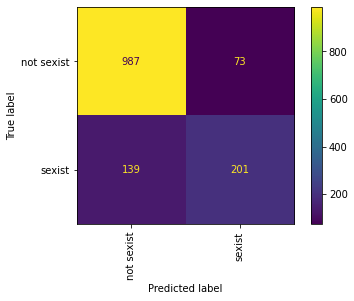

In [ ]:
import matplotlib.pyplot as plt
import numpy
from sklearn import metrics
from sklearn.metrics import ConfusionMatrixDisplay
labels = le.classes_
cm_display = metrics.ConfusionMatrixDisplay.from_predictions(alllabels, allpreds, display_labels = labels, xticks_rotation='vertical')


In [ ]:
from sklearn.metrics import classification_report

print(classification_report(alllabels, allpreds, target_names=labels))

              precision    recall  f1-score   support

  not sexist       0.88      0.93      0.90      1060
      sexist       0.73      0.59      0.65       340

    accuracy                           0.85      1400
   macro avg       0.81      0.76      0.78      1400
weighted avg       0.84      0.85      0.84      1400



### Defining metrics

In [ ]:
from sklearn.metrics import precision_recall_fscore_support, accuracy_score

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    precision, recall, f1, _ = precision_recall_fscore_support(labels, preds, average='macro')
    acc = accuracy_score(labels, preds)
    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }


### Loading a pre-trained model and Tokenization

In [ ]:
# load the model and tokenizer
tokenizer = transformers.AutoTokenizer.from_pretrained("bert-base-uncased", use_fast=True)
model = transformers.AutoModelForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=6).cuda()
labels = sorted(model.config.label2id, key=model.config.label2id.get)

def preprocess_function(examples):
    return tokenizer(examples["text"], truncation=True)

tokenized_df = train_dataset.map(preprocess_function)
val_tokenized_df = val_dataset.map(preprocess_function)
test_tokenized_df = test_dataset.map(preprocess_function)


Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/570 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.weight', 'cls.predictions.transform.dense.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at

  0%|          | 0/1795 [00:00<?, ?ex/s]

  0%|          | 0/359 [00:00<?, ?ex/s]

  0%|          | 0/240 [00:00<?, ?ex/s]

## Train

In [ ]:

import os
import torch
from transformers import TrainingArguments, Trainer
from transformers import DataCollatorWithPadding

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

os.environ["WANDB_DISABLED"] = "true"

metric_name="f1"
training_args = TrainingArguments(
    output_dir="./results",
    evaluation_strategy = "epoch",
    save_strategy = "epoch",
    learning_rate=5e-5,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=4,
    weight_decay=0.01,
    load_best_model_at_end=True,
    metric_for_best_model=metric_name,
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=tokenized_df,
    eval_dataset=val_tokenized_df,
    tokenizer=tokenizer,
    compute_metrics=compute_metrics,
    data_collator=data_collator,
)

trainer.train()

Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).
The following columns in the training set don't have a corresponding argument in `BertForSequenceClassification.forward` and have been ignored: __index_level_0__, text. If __index_level_0__, text are not expected by `BertForSequenceClassification.forward`,  you can safely ignore this message.
This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
***** Running training *****
  Num examples = 1795
  Num Epochs = 4
  Instantaneous batch size per device = 16
  Total train batch size (w. parallel, distributed & accumulation) = 16
  Gradient Accumulation steps = 1
  Total optimization steps = 452
You're using a BertTokenizerFast tokenizer. Please not

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,1.091204,0.604457,0.320156,0.298941,0.346642
2,No log,0.936843,0.674095,0.588590,0.740549,0.562671
3,No log,0.933552,0.668524,0.599540,0.618068,0.590733
4,No log,0.929104,0.671309,0.593018,0.637236,0.577914


The following columns in the evaluation set don't have a corresponding argument in `BertForSequenceClassification.forward` and have been ignored: __index_level_0__, text. If __index_level_0__, text are not expected by `BertForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Evaluation *****
  Num examples = 359
  Batch size = 16
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Saving model checkpoint to ./results/checkpoint-113
Configuration saved in ./results/checkpoint-113/config.json
Model weights saved in ./results/checkpoint-113/pytorch_model.bin
tokenizer config file saved in ./results/checkpoint-113/tokenizer_config.json
Special tokens file saved in ./results/checkpoint-113/special_tokens_map.json
The following columns in the evaluation set don't have a corresponding argument in `BertForSequenceClassification.forward` and have been ignored: __

TrainOutput(global_step=452, training_loss=0.8376891549709624, metrics={'train_runtime': 335.0821, 'train_samples_per_second': 21.428, 'train_steps_per_second': 1.349, 'total_flos': 849451145879772.0, 'train_loss': 0.8376891549709624, 'epoch': 4.0})

In [ ]:
trainer.evaluate(test_tokenized_df)

The following columns in the evaluation set don't have a corresponding argument in `BertForSequenceClassification.forward` and have been ignored: __index_level_0__, text. If __index_level_0__, text are not expected by `BertForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Evaluation *****
  Num examples = 240
  Batch size = 16


{'eval_loss': 0.966619610786438,
 'eval_accuracy': 0.6625,
 'eval_f1': 0.5524377249341607,
 'eval_precision': 0.5606051406597855,
 'eval_recall': 0.5527342548587132,
 'eval_runtime': 3.4059,
 'eval_samples_per_second': 70.466,
 'eval_steps_per_second': 4.404,
 'epoch': 4.0}

The following columns in the test set don't have a corresponding argument in `BertForSequenceClassification.forward` and have been ignored: __index_level_0__, text. If __index_level_0__, text are not expected by `BertForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Prediction *****
  Num examples = 240
  Batch size = 16


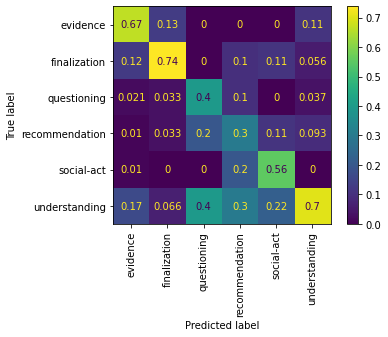

In [ ]:
import matplotlib.pyplot as plt
import numpy
from sklearn import metrics
from sklearn.metrics import ConfusionMatrixDisplay

preds = trainer.predict(test_tokenized_df)
labels = le.classes_
cm_display = metrics.ConfusionMatrixDisplay.from_predictions(preds.label_ids, np.argmax(preds.predictions, axis=1), display_labels = labels, xticks_rotation='vertical', normalize='pred')


# Hyperparameter search

In [ ]:
! pip install optuna
! pip install ray[tune]

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 348 kB 29.9 MB/s 
     |████████████████████████████████| 209 kB 66.7 MB/s 
     |████████████████████████████████| 81 kB 10.3 MB/s 
     |████████████████████████████████| 78 kB 8.3 MB/s 
     |████████████████████████████████| 147 kB 70.9 MB/s 
     |████████████████████████████████| 50 kB 7.1 MB/s 
     |████████████████████████████████| 112 kB 71.3 MB/s 
  Created wheel for pyperclip: filename=pyperclip-1.8.2-py3-none-any.whl size=11137 sha256=c37994e11e0f4f78728f1899aca8f6c67da17e0f62082fd406ed35bd345f9db9
  Stored in directory: /root/.cache/pip/wheels/9f/18/84/8f69f8b08169c7bae2dde6bd7daf0c19fca8c8e500ee620a28
Successfully built pyperclip
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 60.5 MB 1.3 MB/s 
     |████████████████████████████████| 8.8 MB 64.4

In [ ]:
def model_init():
    return AutoModelForSequenceClassification.from_pretrained("roberta-base", num_labels=6, return_dict=True).cuda()

In [ ]:
trainer = Trainer(
    model_init=model_init,
    args=training_args,
    train_dataset=tokenized_df,
    eval_dataset=val_tokenized_df,
    tokenizer=tokenizer,
    compute_metrics=compute_metrics,
    data_collator=data_collator,
)

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--roberta-base/snapshots/ff46155979338ff8063cdad90908b498ab91b181/config.json
Model config RobertaConfig {
  "_name_or_path": "roberta-base",
  "architectures": [
    "RobertaForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "bos_token_id": 0,
  "classifier_dropout": null,
  "eos_token_id": 2,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "id2label": {
    "0": "LABEL_0",
    "1": "LABEL_1",
    "2": "LABEL_2",
    "3": "LABEL_3",
    "4": "LABEL_4",
    "5": "LABEL_5"
  },
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "label2id": {
    "LABEL_0": 0,
    "LABEL_1": 1,
    "LABEL_2": 2,
    "LABEL_3": 3,
    "LABEL_4": 4,
    "LABEL_5": 5
  },
  "layer_norm_eps": 1e-05,
  "max_position_embeddings": 514,
  "model_type": "roberta",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 1,
  "position_embedding_type": "absolute",


In [ ]:
train_dataset = tokenized_df.shard(index=1, num_shards=10) 

In [ ]:

def my_hp_space(trial):
    return {
        "learning_rate": trial.suggest_float("learning_rate", 1e-4, 1e-2, log=True),
        "num_train_epochs": trial.suggest_int("num_train_epochs", 1, 5),
        "seed": trial.suggest_int("seed", 1, 40),
        "per_device_train_batch_size": trial.suggest_categorical("per_device_train_batch_size", [4, 8]),
    }

In [ ]:
best_run = trainer.hyperparameter_search(n_trials=7, direction="maximize", hp_space=my_hp_space)

[I 2022-10-26 11:35:53,352] A new study created in memory with name: no-name-df4bbfa6-8311-4f3f-87cc-be50edc95f8f
Trial: {'num_train_epochs': 3, 'seed': 1, 'per_device_train_batch_size': 8}
loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--roberta-base/snapshots/ff46155979338ff8063cdad90908b498ab91b181/config.json
Model config RobertaConfig {
  "_name_or_path": "roberta-base",
  "architectures": [
    "RobertaForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "bos_token_id": 0,
  "classifier_dropout": null,
  "eos_token_id": 2,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "id2label": {
    "0": "LABEL_0",
    "1": "LABEL_1",
    "2": "LABEL_2",
    "3": "LABEL_3",
    "4": "LABEL_4",
    "5": "LABEL_5"
  },
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "label2id": {
    "LABEL_0": 0,
    "LABEL_1": 1,
    "LABEL_2": 2,
    "LABEL_3": 3,
    "LABEL_4": 4,
    "LABEL_5": 5
  },
  "layer_norm_ep

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,1.113334,0.611691,0.340513,0.474574,0.357308
2,No log,0.911439,0.674322,0.565374,0.624588,0.567176
3,1.082500,0.894551,0.682672,0.534869,0.658309,0.506822


The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassification.forward` and have been ignored: text, __index_level_0__. If text, __index_level_0__ are not expected by `RobertaForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Evaluation *****
  Num examples = 479
  Batch size = 8
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Saving model checkpoint to ./results/run-0/checkpoint-240
Configuration saved in ./results/run-0/checkpoint-240/config.json
Model weights saved in ./results/run-0/checkpoint-240/pytorch_model.bin
tokenizer config file saved in ./results/run-0/checkpoint-240/tokenizer_config.json
Special tokens file saved in ./results/run-0/checkpoint-240/special_tokens_map.json
The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassificat

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,0.984941,0.638831,0.403135,0.652699,0.398029
2,1.203700,0.960847,0.688935,0.580796,0.764656,0.551835


The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassification.forward` and have been ignored: text, __index_level_0__. If text, __index_level_0__ are not expected by `RobertaForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Evaluation *****
  Num examples = 479
  Batch size = 8
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Saving model checkpoint to ./results/run-1/checkpoint-479
Configuration saved in ./results/run-1/checkpoint-479/config.json
Model weights saved in ./results/run-1/checkpoint-479/pytorch_model.bin
tokenizer config file saved in ./results/run-1/checkpoint-479/tokenizer_config.json
Special tokens file saved in ./results/run-1/checkpoint-479/special_tokens_map.json
The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassificat

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,1.106787,0.613779,0.331256,0.327107,0.350768
2,No log,0.934219,0.659708,0.522625,0.564199,0.524895
3,1.073600,0.907216,0.686848,0.575479,0.591991,0.580594


The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassification.forward` and have been ignored: text, __index_level_0__. If text, __index_level_0__ are not expected by `RobertaForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Evaluation *****
  Num examples = 479
  Batch size = 8
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Saving model checkpoint to ./results/run-2/checkpoint-240
Configuration saved in ./results/run-2/checkpoint-240/config.json
Model weights saved in ./results/run-2/checkpoint-240/pytorch_model.bin
tokenizer config file saved in ./results/run-2/checkpoint-240/tokenizer_config.json
Special tokens file saved in ./results/run-2/checkpoint-240/special_tokens_map.json
The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassificat

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,1.121096,0.640919,0.363335,0.497747,0.376575
2,1.216200,0.946321,0.678497,0.544211,0.608602,0.535463
3,0.885100,0.979936,0.682672,0.557431,0.606389,0.558408


The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassification.forward` and have been ignored: text, __index_level_0__. If text, __index_level_0__ are not expected by `RobertaForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Evaluation *****
  Num examples = 479
  Batch size = 8
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Saving model checkpoint to ./results/run-3/checkpoint-479
Configuration saved in ./results/run-3/checkpoint-479/config.json
Model weights saved in ./results/run-3/checkpoint-479/pytorch_model.bin
tokenizer config file saved in ./results/run-3/checkpoint-479/tokenizer_config.json
Special tokens file saved in ./results/run-3/checkpoint-479/special_tokens_map.json
The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassificat

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,1.082152,0.609603,0.326724,0.306012,0.351138
2,No log,0.951684,0.643006,0.390977,0.450598,0.395291


The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassification.forward` and have been ignored: text, __index_level_0__. If text, __index_level_0__ are not expected by `RobertaForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Evaluation *****
  Num examples = 479
  Batch size = 8
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Saving model checkpoint to ./results/run-4/checkpoint-240
Configuration saved in ./results/run-4/checkpoint-240/config.json
Model weights saved in ./results/run-4/checkpoint-240/pytorch_model.bin
tokenizer config file saved in ./results/run-4/checkpoint-240/tokenizer_config.json
Special tokens file saved in ./results/run-4/checkpoint-240/special_tokens_map.json
The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassificat

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,1.087048,0.601253,0.330177,0.398420,0.348270
2,No log,0.987964,0.649269,0.452202,0.610467,0.436935


The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassification.forward` and have been ignored: text, __index_level_0__. If text, __index_level_0__ are not expected by `RobertaForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Evaluation *****
  Num examples = 479
  Batch size = 8
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Saving model checkpoint to ./results/run-5/checkpoint-240
Configuration saved in ./results/run-5/checkpoint-240/config.json
Model weights saved in ./results/run-5/checkpoint-240/pytorch_model.bin
tokenizer config file saved in ./results/run-5/checkpoint-240/tokenizer_config.json
Special tokens file saved in ./results/run-5/checkpoint-240/special_tokens_map.json
The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassificat

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,1.138215,0.613779,0.328858,0.309213,0.353024


The following columns in the evaluation set don't have a corresponding argument in `RobertaForSequenceClassification.forward` and have been ignored: text, __index_level_0__. If text, __index_level_0__ are not expected by `RobertaForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Evaluation *****
  Num examples = 479
  Batch size = 8
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
[I 2022-10-26 11:57:31,138] Trial 6 pruned. 


In [ ]:
best_run

BestRun(run_id='1', objective=2.586222174779774, hyperparameters={'num_train_epochs': 2, 'seed': 1, 'per_device_train_batch_size': 4})

To reproduce the best training, just set the hyperparameters in your TrainingArgument before creating a Trainer:

In [ ]:
for n, v in best_run.hyperparameters.items():
    setattr(trainer.args, n, v)

trainer.train()

# Explainability

In [ ]:
# this defines an explicit python function that takes a list of strings and outputs scores for each class
def f(x):
    tv = torch.tensor([tokenizer.encode(v, padding='max_length', max_length=128, truncation=True) for v in x]).cuda()
    attention_mask = (tv!=0).type(torch.int64).cuda()
    outputs = model(tv,attention_mask=attention_mask)[0].detach().cpu().numpy()
    scores = (np.exp(outputs).T / np.exp(outputs).sum(-1)).T
    val = sp.special.logit(scores)
    return val

In [ ]:
method = "custom tokenizer"

# build an explainer by passing a transformers tokenizer
if method == "transformers tokenizer":
    explainer = shap.Explainer(f, tokenizer, output_names=labels)

# build an explainer by explicitly creating a masker
elif method == "default masker":
    masker = shap.maskers.Text(r"\W") # this will create a basic whitespace tokenizer
    explainer = shap.Explainer(f, masker, output_names=labels)

# build a fully custom tokenizer
elif method == "custom tokenizer":
    import re

    def custom_tokenizer(s, return_offsets_mapping=True):
        """ Custom tokenizers conform to a subset of the transformers API.
        """
        pos = 0
        offset_ranges = []
        input_ids = []
        for m in re.finditer(r"\W", s):
            start, end = m.span(0)
            offset_ranges.append((pos, start))
            input_ids.append(s[pos:start])
            pos = end
        if pos != len(s):
            offset_ranges.append((pos, len(s)))
            input_ids.append(s[pos:])
        out = {}
        out["input_ids"] = input_ids
        if return_offsets_mapping:
            out["offset_mapping"] = offset_ranges
        return out

    masker = shap.maskers.Text(custom_tokenizer)
    explainer = shap.Explainer(f, masker, output_names=labels)

In [ ]:
shap_values = explainer(testing_data['text'][:4])
shap.plots.text(shap_values)

# RFC-Predecessor pairs

In [ ]:
import json
import pandas as pd
from datetime import datetime

In [ ]:
actions_file_path = "/content/rfc_predecessor_pairs_actions (2).txt"
pairs_file_path = "/content/rfc_predecessor_pairs_plain_text (4).json"
new_paris_file_path = "/content/rfc_predecessor_pairs_plain_text_and_actions.json"

In [ ]:
actions_file = open(actions_file_path, 'r')
actions = []
for line in actions_file:
    action = json.loads(str(line))
    actions.append(action)
    
print(str(len(actions)))
actions_file.close()

17553


In [ ]:
pairs_file = open(pairs_file_path, 'r')
pairs = json.load(pairs_file)['rfc_predecessor_pairs']
print(str(len(pairs)))

421


In [ ]:
sum = 0
for pair in pairs:
    rfc_conversation_id = pair['rfc_id']
    rfc_actions = [action for action in actions if action['conversation_id'] == rfc_conversation_id]
    sum = sum + len(rfc_actions)
    pair['rfc_actions'] = rfc_actions
    
    predecessor_conversation_id = pair['predecessor_id']
    predecessor_actions = [action for action in actions if action['conversation_id'] == predecessor_conversation_id]
    pair['predecessor_actions'] = predecessor_actions
    
json_file = open(new_paris_file_path,'w+')    
json.dump({'rfc_predecessor_pairs':pairs}, json_file)
json_file.close()

In [ ]:
'''
This function reconstructs the latest state of a given conversation from actions in WikiConv format


conversation_actions - all WikiConv actions that make up the conversation as json objects

limit_date - If given reconstruct conversation only with actions that happened earlier then this limit_data.
Timestamp in format "%Y-%m-%d %X %Z". If given the conversation will only be reconstructed witha action that took place before that time. 


return - Returns a list of WikiConv actions as json objects in chronological order. The content of these actions in the given order 
is the reconstructed conversation.
'''
def reconstruct_conversation_v1(conversation_actions, limit_date=None):

    # Sort actions by timestamp
    sorted_actions = sorted(conversation_actions, key = lambda x:datetime.strptime(x['timestamp'], "%Y-%m-%d %X %Z").timestamp())
    if limit_date != None:
        # Remove actions that took place after date_limit
        sorted_actions = list(filter(lambda x:datetime.strptime(x['timestamp'], "%Y-%m-%d %X %Z") < datetime.strptime(limit_date, "%Y-%m-%d %X %Z"), sorted_actions))

    conversation = []
    print("Actions after sorting out: " + str(len(sorted_actions)))
    for action_json in sorted_actions:
        if not 'parent_id' in action_json:
            # Should be CREATION or ADDITION
            # For each CREATION or ADDITION create a new list, that will later be extended by all deletion, restorations and modifications
            # that concern this creation or addition.
            if action_json['type'] == 'CREATION':
                #print("Handling CREATION. 'id':" + str(action_json['id']))
                conversation.append([action_json])
            elif action_json['type'] == 'ADDITION':
                #print("Handling ADDITION. 'id':" + str(action_json['id']))
                conversation.append([action_json])
            else:
                print("Action without parent_id is wheater CREATION nor ADDITION")

    for action_json in sorted_actions:

        if 'parent_id' in action_json:
            # Should be DELETION, RESTORATION or MODIFICATION
            if action_json['type'] == 'DELETION':
                #print("Handling DELETION. 'id':" + str(action_json['id']) + " 'parent_id':" + str(action_json['parent_id']))
                action_has_parent = False
                for action_list in conversation:
                    list_contains_parent_id = False
                    for action in action_list:
                        if action['id'] == action_json['parent_id']:
                            list_contains_parent_id = True
                            action_has_parent = True
                    if list_contains_parent_id:
                        action_list.append(action_json)
                if not action_has_parent:
                    print("Deletion without parent")

            elif action_json['type'] == 'RESTORATION':
                #print("Handling RESTORATION. 'id':" + str(action_json['id']) + " 'parent_id':" + str(action_json['parent_id']))
                parent_index = None
                action_has_parent = False
                for action_list in conversation:
                    list_contains_parent_id = False
                    for action in action_list:
                        if action['id'] == action_json['parent_id']:
                            list_contains_parent_id = True
                            action_has_parent = True
                    if list_contains_parent_id:
                        action_list.append(action_json)
                if not action_has_parent:
                    print("Restoration without parent")

            elif action_json['type'] == 'MODIFICATION':
                #print("Handling MODIFICATION. 'id':" + str(action_json['id']) + " 'parent_id':" + str(action_json['parent_id']))
                action_has_parent = False
                for action_list in conversation:
                    list_contains_parent_id = False
                    for action in action_list:
                        if action['id'] == action_json['parent_id']:
                            list_contains_parent_id = True
                            action_has_parent = True
                    if list_contains_parent_id:
                        action_list.append(action_json)
                if not action_has_parent:
                    print("Modification without parent")

            else:
                print("Action with parent_id is wheater DELETION, RESTORATION or MODIFICATION")

    final_actions = []
    for action_list in conversation:
        last_action = action_list[len(action_list) - 1]
        final_actions.append(last_action)
    
    # Sort CREATTIONs and ADDDITONS with same timestamp so that CREATTION comes first
    final_conversation = []
    for action in final_actions:
        if action['type'] == 'ADDITION':
            # Look for creation with same timestamp to put before this addidtion
            for other_action in final_actions:
                if other_action['type'] == 'CREATION' and action['timestamp'] == other_action['timestamp']:
                    final_conversation.append(other_action)
        if not action['id'] in list(map(lambda x:x['id'], final_conversation)):
            final_conversation.append(action)

    return final_conversation

In [ ]:
new_pairs_file = open(new_paris_file_path, 'r')
pairs =  json.load(new_pairs_file)
new_pairs_file.close()
# pair = pairs['rfc_predecessor_pairs'][1]


In [ ]:
# full_conversation = []
# first_rfc_conversations = reconstruct_conversation_v1(pair['predecessor_actions'], limit_date=None) # key 'frc_actions' to see rft conversations
# for action in first_rfc_conversations:
#             # print("\n---------\n")
#             full_conversation.append(action['cleaned_content']) # key ' content' to have the markup text with user names etc.

In [ ]:
pair_test = pairs['rfc_predecessor_pairs'][1]

In [ ]:
# rfc_conv_test = {"id": [], "cleaned_content": [], "toxicity":[], "sever_toxicity":[], "user_id":[], "indentation":[]}
# full_conversation = []
# rfc_preds = {}
# rfc_conversation = reconstruct_conversation_v1(pair_test['rfc_actions'], limit_date=None)
# for action in rfc_conversation:
#             full_conversation.append(action['cleaned_content'])

#             for key in rfc_conv_test.keys():
#               rfc_conv_test[key].append(action[key])            

# # Creating the conversation dataframe:
# rfc_conv_df = pd.DataFrame.from_dict(rfc_conv_test)

# # Only text for prediction by the trained model:
# conv_text = pd.DataFrame(full_conversation, columns=['text'])
# conv_dataset = Dataset.from_pandas(conv_text)
# conv_tokenized_df = conv_dataset.map(preprocess_function)

# # label prediction
# rfc_preds = trainer.predict(conv_tokenized_df)
# rfc_conv_df["prediction"] =  list(np.argmax(rfc_preds.predictions, axis=1))
# rfc_conv_df["label"] = list(le.inverse_transform(rfc_conv_df['prediction']))


# rfc_conv_df.head()

#===========================================================================================================
from datasets import Dataset, DatasetDict

full_dataset = []
full_rfc_predecessor_list = []

for pair in pairs['rfc_predecessor_pairs']:
  
  # Discourse Act label prediction for rfc texts:
  rfc_conv = {"id": [], "cleaned_content": [], "toxicity":[], "sever_toxicity":[], "indentation":[], "type":[]}
  rfc_full_conversation = []
  rfc_preds = {}
  rfc_conversation = reconstruct_conversation_v1(pair['rfc_actions'], limit_date=None) 
  for action in rfc_conversation:
            rfc_full_conversation.append(action['cleaned_content'])
                        
            for key in rfc_conv.keys():
              rfc_conv[key].append(action[key])
  # Creating the conversation dataframe:
  rfc_conv_df = pd.DataFrame.from_dict(rfc_conv)

  # Only text for prediction by the trained model:
  rfc_conv_text = pd.DataFrame(rfc_full_conversation, columns=['text'])
  rfc_conv_dataset = Dataset.from_pandas(rfc_conv_text)
  rfc_conv_tokenized_df = rfc_conv_dataset.map(preprocess_function)

  # label prediction
  rfc_preds = trainer.predict(rfc_conv_tokenized_df)
  rfc_conv_df["prediction"] =  list(np.argmax(rfc_preds.predictions, axis=1))
  rfc_conv_df["label"] = list(le.inverse_transform(rfc_conv_df['prediction']))

  #============================

  # Discourse Act label prediction for predecessor texts:
  predecessor_full_conversation = []
  predecessor_preds = {}
  predecessor_conv = {"id": [], "cleaned_content": [], "toxicity":[], "sever_toxicity":[], "indentation":[], "type":[]}
  predecessor_conversation = reconstruct_conversation_v1(pair['predecessor_actions'], limit_date=None)
  for action in predecessor_conversation:
            predecessor_full_conversation.append(action['cleaned_content']) # key ' content' to have the markup text with user names etc.

            for key in predecessor_conv.keys():
              predecessor_conv[key].append(action[key])
  # Creating the conversation dataframe:
  predecessor_conv_df = pd.DataFrame.from_dict(predecessor_conv)

  # Only text for prediction by the trained model:
  predecessor_conv_text = pd.DataFrame(predecessor_full_conversation, columns=['text'])
  predecessor_conv_dataset = Dataset.from_pandas(predecessor_conv_text)
  predecessor_conv_tokenized_df = predecessor_conv_dataset.map(preprocess_function)

  # label prediction
  predecessor_preds = trainer.predict(predecessor_conv_tokenized_df)
  predecessor_conv_df["prediction"] =  list(np.argmax(predecessor_preds.predictions, axis=1))
  predecessor_conv_df["label"] = list(le.inverse_transform(predecessor_conv_df['prediction']))

  
  rfc_predecessor = DatasetDict({
    "rfc_conv": Dataset.from_pandas(rfc_conv_df),
    "predecessor_conv": Dataset.from_pandas(predecessor_conv_df)})
  
  rfc_predecessor_list = [rfc_conv_df, predecessor_conv_df]

  full_rfc_predecessor_list.append(rfc_predecessor_list)
  full_dataset.append(rfc_predecessor)

Total number of actions in all conversations

In [ ]:
sum_actions = 0
for pair in full_rfc_predecessor_list:
  for conv in pair:
    sum_actions+=len(conv)
    
sum_actions

10750

### General Features of pairs of Conversations:

In [ ]:
def pairs_general_features(pair):

  features = {
      "rfc": {
          "comments" : len(pair[0]),
          "toxicity_avg": pair[0]['toxicity'].astype(float).mean(),
          "sever_toxicity_avg": pair[0]['sever_toxicity'].astype(float).mean(),
          "indentation_avg": pair[0]['indentation'].astype(float).mean(),
          # "deletion_modification": pair[0][(pair['type']=='DELETION') or (pair['type']=='MODIFICATION')].count()
      },
      "predecessor": {
          "comments" : len(pair[1]),
          "toxicity_avg": pair[1]['toxicity'].astype(float).mean(),
          "sever_toxicity_avg": pair[1]['sever_toxicity'].astype(float).mean(),
          "indentation_avg": pair[1]['indentation'].astype(float).mean(),
          # "deletion_modification": pair[1][(pair['type']=='DELETION') or (pair['type']=='MODIFICATION')].count()
      }
  }
  # print("RfC Features: ", '\n')
  # print("Number of comments: ", features.rfc.comments, '\n')
  # print("toxicity avgerage: ", features.rfc.toxicity_avg, '\n')
  # print("sever_toxicity_avgerage: ", features.rfc.sever_toxicity_avg, '\n')
  # print("indentation avgerage: ", features.rfc.indentation_avg, '\n')

  # print("Predecessor Features: ", '\n')
  # print("Number of comments in Predecessor conversation: ", features.predecessor.comments, '\n')
  # print("toxicity avgerage: ", features.predecessor.toxicity_avg, '\n')
  # print("sever_toxicity_avgerage: ", features.predecessor.sever_toxicity_avg, '\n')
  # print("indentation avgerage: ", features.predecessor.indentation_avg, '\n')
  return features


In [ ]:
pairs_general_features(full_rfc_predecessor_list[0])

{'rfc': {'comments': 3,
  'toxicity_avg': 0.03653317666666667,
  'sever_toxicity_avg': 0.017055916666666667,
  'indentation_avg': -0.3333333333333333},
 'predecessor': {'comments': 7,
  'toxicity_avg': 0.06588353685714286,
  'sever_toxicity_avg': 0.019699150600000003,
  'indentation_avg': 1.1428571428571428}}

### Discourse Act label prediction for RfC-Predecessor pairs

In [ ]:
!pip install datasets

In [ ]:
# from datasets import Dataset

# full_dataset = []
# for pair in pairs['rfc_predecessor_pairs']:
  
#   # Discourse Act label prediction for rfc texts:
#   rfc_conv = {"id": [], "text": [], "prediction":[], "label":[]}
#   rfc_full_conversation = []
#   rfc_preds = {}
#   rfc_conversation = reconstruct_conversation_v1(pair['rfc_actions'], limit_date=None) # key 'frc_actions' to see rft conversations
#   for action in rfc_conversation:
#             rfc_full_conversation.append(action['cleaned_content'])
                        
#             rfc_conv["id"].append(action['id']) # key ' content' to have the markup text with user names etc.
#             rfc_conv["text"].append(action['cleaned_content'])

#   conv_df = pd.DataFrame(rfc_full_conversation, columns=['text'])
#   conv_dataset = Dataset.from_pandas(conv_df)
#   conv_tokenized_df = conv_dataset.map(preprocess_function)
#   rfc_preds = trainer.predict(conv_tokenized_df)
#   rfc_conv["prediction"] =  list(np.argmax(rfc_preds.predictions, axis=1))
#   rfc_conv["label"] = list(le.inverse_transform(rfc_conv['prediction']))

#   # Discourse Act label prediction for predecessor texts:
#   predecessor_full_conversation = []
#   predecessor_preds = {}
#   predecessor_conv = {"id": [], "text": [], "prediction":[], "label":[]}
#   predecessor_conversation = reconstruct_conversation_v1(pair['predecessor_actions'], limit_date=None)
#   for action in predecessor_conversation:
#             predecessor_full_conversation.append(action['cleaned_content']) # key ' content' to have the markup text with user names etc.

#             predecessor_conv["id"].append(action['id']) 
#             predecessor_conv["text"].append(action['cleaned_content'])
#   p_conv_df = pd.DataFrame(predecessor_full_conversation, columns=['text'])
#   p_conv_dataset = Dataset.from_pandas(p_conv_df)
#   p_conv_tokenized_df = p_conv_dataset.map(preprocess_function)
#   predecessor_preds = trainer.predict(p_conv_tokenized_df)
#   predecessor_conv["prediction"] =  list(np.argmax(predecessor_preds.predictions, axis=1))
#   predecessor_conv["label"] = list(le.inverse_transform(predecessor_conv['prediction']))
  
#   rfc_predecessor = {
#     'rfc_conv': Dataset.from_dict(rfc_conv),
#     'predecessor_conv': Dataset.from_dict(predecessor_conv)}
  
#   full_dataset.append(rfc_predecessor)


Let's take a look at the first action of the first conversation

In [ ]:
conv_length = len(full_dataset[0]['rfc_conv'])
shap_values = explainer(full_dataset[0]['rfc_conv'][:conv_length-1]['text'])
shap.plots.text(shap_values)

In [ ]:
full_dataset[0]['predecessor_conv']

Dataset({
    features: ['id', 'text', 'prediction', 'label'],
    num_rows: 7
})

In [ ]:
conv_length = len(full_dataset[0]['predecessor_conv'])
shap_values = explainer(full_dataset[0]['predecessor_conv'][:conv_length]['text'])
shap.plots.text(shap_values)

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 8it [00:27,  5.41s/it]
